# Tôi tự học Keras 

## Bài 9: Survival analysis bằng Deep learning

### Giới thiệu:

Hôm trước, có một bạn thành viên trong nhóm đặt câu hỏi : liệu Deep learning có thể ứng dụng cho bài toán Survival analysis không ? Đây là một vấn đề thú vị, nên Nhi lập tức tìm kiếm thông tin trên mạng, và nhanh chóng tìm ra luận án Master của anh Egil Martinsson:  https://ragulpr.github.io/assets/draft_master_thesis_martinsson_egil_wtte_rnn_2016.pdf ; trong đó anh ta sử dụng một mạng neuron RNN (có thể là Gated recurrent unit (GRU) hoặc LSTM) với dữ liệu đầu vào là một tensor 3D ghi lại diễn tiến của nhiều features; và lớp output, hàm loss cùng activation được hiệu chỉnh để ước lượng giá trị 2 tham số của một phân phối Weibull cho biến ngẫu nhiên rời rạc. Từ 2 tham số này, ta có thể ước tính được thời gian cho đến khi sự kiến xảy ra (survival time) tại mỗi thời điểm trong tiến trình theo dõi.

<img src="https://raw.githubusercontent.com/ragulpr/wtte-rnn/master/readme_figs/fig_rnn_weibull.png">

<img src="https://raw.githubusercontent.com/ragulpr/wtte-rnn/master/readme_figs/solution_beta_2.gif">

Ý tưởng này gần giống như mô hình Semi-parametric distributional (package gamlss) mà Nhi đã có lần giới thiệu, theo đó, bài toán hồi quy được giải quyết thông qua giả định về một họ phân phối phù hợp cho biến kết quả (thí dụ Gamma, Beta) sau đó mỗi tham số (vị trí trung tâm, scale, kiểu hình) của phân phối đó sẽ được ước tính bằng một mô hình riêng biệt. 

Khi áp dụng ý tưởng này cho mạng neuron, bản chất của cách làm vẫn giữ nguyên, tức là thay vì ước tính trực tiếp biến kết quả  (ở đây là survival time), chúng ta dùng 1 phân phối cho biến liên tục hay rời rạc như phương tiện trung gian, và xây dựng mạng neuron để xuất kết quả là 2 hoặc 3 tham số cho phân bố này. Như bạn đã biết, phân phối Weibull đã được sử dụng rất phổ biến trong phương pháp Parametric survival analysis. Tuy nhiên, thay vì xây dựng 2 mạng neuron khác nhau cho mỗi tham số, ta chỉ cần 1 cấu trúc mạng neuron duy nhất (đây là lợi thế đáng lưu ý của Deep learning), ta chỉ cần can thiệp lên lớp neuron cuối cùng bằng cách áp dụng hàm activation riêng cho mỗi neuron output, và dùng 1 hàm log_likelihood cho phân phối Weibull như hàm loss trong quá trình huấn luyện.

Từ ý tưởng và code của anh Egil Martinsson: https://github.com/ragulpr/wtte-rnn , Nhi giới thiệu với các bạn thí nghiệm Survival Deep learning trong bài thực hành số 9 của series "Tôi tự học Keras" này.

## Tải các packages cần thiết

In [106]:
import numpy as np
import pandas as pd

from keras.models import *
from keras.layers import *
from keras.layers.wrappers import TimeDistributed
from keras import backend as K
from keras import callbacks
from keras.optimizers import adam
from keras.callbacks import History

from sklearn import pipeline
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import *

from matplotlib import pyplot as plt
import seaborn as sns

import warnings

warnings.filterwarnings("ignore")
np.random.seed(123)
pd.set_option("display.max_rows",10)

## Mô tả thí nghiệm

Trong thí nghiệm này, mục tiêu là ước tính tuổi thọ của một cái máy (tính bằng ngày) dựa vào diễn tiến hằng ngày của tín hiệu  ghi nhận từ 24 cảm biến khác nhau bên trong cái máy. Một tập dữ liệu train chứa 24 chuỗi tín hiệu cho 100 cái máy trong các khoảng thời gian khác nhau cho đến khi cái máy bị hư hỏng, dùng để huấn luyện mô hình. Một tập dữ liệu test chứa thông tin 24 chuỗi tín hiệu cho 100 máy khác, được theo dõi trong 100 ngày, và kết quả tuổi thọ thực tế của mỗi cái máy. 

Các bạn bác sĩ có lẽ sẽ ít hứng thú với bài toán này, tuy nhiên các bạn có thể tưởng tượng rằng vấn đề tương tự cũng có thể gặp trong ngành Y khoa, thí dụ : sự theo dõi huyết áp/ hoặc một chỉ số sinh lý, biomarker nào đó hằng ngày cho phép dự đoán thời gian an toàn cho đến khi 1 tai biến/sự cố xảy ra, thí dụ cơn kịch phát bệnh COPD, suy thận, rối loạn chuyển hóa, nhồi máu cơ tim, hiện tượng thải ghép, hôn mê, tử vong...

## Bước 1: Tải dữ liệu

In [9]:
id_col = 'unit' # Cột thứ nhất: mã số định danh cho những cái máy
time_col = 'time' # cột thứ 2: thời điểm lấy mẫu trong tiến trình theo dõi
feature_cols = [ 'opset_1', 'opset_2', 'opset_3'] + ['sensor_{}'.format(x) for x in range(1,22)] # 24 features
column_names = [id_col, time_col] + feature_cols # Nhập chung thành 26 cột

# Tải dữ liệu train, test_x và test_y, đặt tên lại cho 26 cột
train_orig = pd.read_csv('train.csv', header=None, names=column_names)
test_x_orig = pd.read_csv('test_x.csv', header=None, names=column_names)
test_y_orig = pd.read_csv('test_y.csv', header=None, names=['Time'])

In [10]:
train_orig.shape  # 20631 mẫu (thời điểm theo dõi 100 cái máy)

(20631, 26)

In [5]:
test_x_orig.shape # 13096 mẫu (thời điểm theo dõi 100 cái máy)

(13096, 26)

In [6]:
test_y_orig.shape  # 100 cái máy

(100, 1)

### Tập train

In [11]:
train_orig

,unit,time,opset_1,opset_2,opset_3,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,...,sensor_12,sensor_13,sensor_14,sensor_15,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,519.49,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,519.68,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,520.01,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,519.67,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640


### 24 chuỗi tín hiệu theo dõi trên 2 cái máy đầu tiên

Lưu ý: Tuổi thọ = thời gian theo dõi có thể khác nhau cho từng máy,
Ta áp dụng 1 hoán chuyển MinMax để thang đo của mỗi tín hiệu là như nhau, từ 0:1,
Có một số tín hiệu rất ít biến đổi (variance = 0), ta có thể phải loại bỏ chúng khi dựng mô hình.

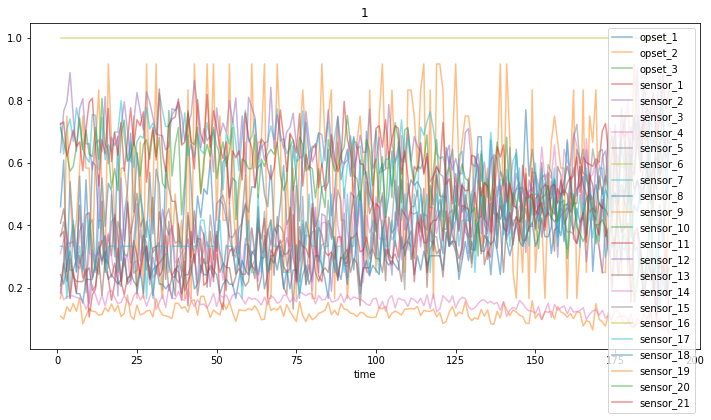

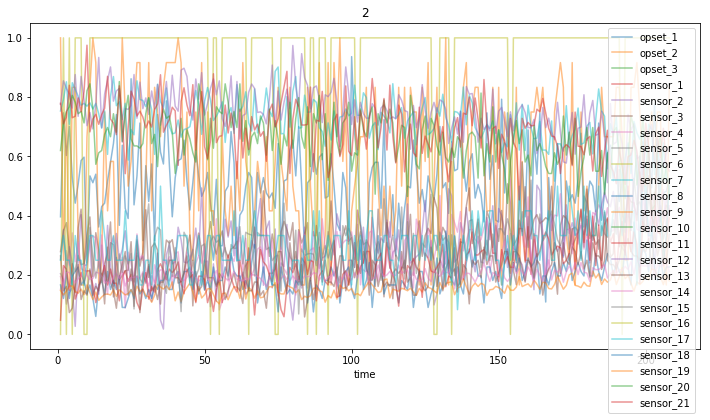

In [216]:
mins=train_orig[feature_cols].min()
maxs=train_orig[feature_cols].max()

for unit, grp in train_orig.iloc[0:400].groupby('unit'):
    df=grp.set_index('time')
    df = df[feature_cols]
    df=(df - mins)/ (maxs - mins)
    df.plot(figsize=(12,6),alpha=0.5)
    plt.title(unit)
    plt.show()

### Tập test_x và kết quả test_y

In [12]:
test_x_orig

,unit,time,opset_1,opset_2,opset_3,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,...,sensor_12,sensor_13,sensor_14,sensor_15,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,100.0,518.67,643.24,1599.45,1415.79,14.62,...,520.69,2388.00,8213.28,8.4715,0.03,394,2388,100.0,38.65,23.1974
13092,100,195,-0.0011,-0.0001,100.0,518.67,643.22,1595.69,1422.05,14.62,...,521.05,2388.09,8210.85,8.4512,0.03,395,2388,100.0,38.57,23.2771
13093,100,196,-0.0006,-0.0003,100.0,518.67,643.44,1593.15,1406.82,14.62,...,521.18,2388.04,8217.24,8.4569,0.03,395,2388,100.0,38.62,23.2051
13094,100,197,-0.0038,0.0001,100.0,518.67,643.26,1594.99,1419.36,14.62,...,521.33,2388.08,8220.48,8.4711,0.03,395,2388,100.0,38.66,23.2699


In [13]:
test_y_orig

,Time
0,112
1,98
2,69
3,82
4,91
...,...
95,137
96,82
97,59
98,117


## Bước 2: Sơ chế dữ liệu

Trong bước này, ta sẽ thực hiện một số thao tác như sau:

1) Loại bỏ các features có variance = 0,

2) Chuẩn hóa thang đo dữ liệu về 0:1

3) Tạo 2 tập dữ liệu train, test để huấn luyện, kiểm định mô hình, từ tập dữ liệu train_origin và test_x_origin

In [62]:
scaler=pipeline.Pipeline(steps=[
    ('minmax', MinMaxScaler(feature_range=(-1, 1))),
    ('remove_constant', VarianceThreshold())])

scaler=scaler.fit(train_orig[feature_cols])

In [69]:
def data_scaler(trainset,testset):
    # Tạo pipeline với 2 hàm hoán chuyển: Scaler 0:1 và Loại bỏ các features chỉ toàn hằng số
    scaler=pipeline.Pipeline(steps=[
     ('minmax', MinMaxScaler(feature_range=(-1, 1))),
     ('remove_constant', VarianceThreshold())])
    # Luyện scaler
    scaler=scaler.fit(trainset[feature_cols])
    # Hoán chuyển, ngoại trừ 2 cột đầu tiên
    S_train=np.concatenate([trainset[[id_col, time_col]],scaler.transform(trainset[feature_cols])], axis=1)
    S_test=np.concatenate([testset[[id_col, time_col]],scaler.transform(testset[feature_cols])], axis=1)
    # Unit và Time được đưa về thang index 0 để Python có thể đếm
    S_train[:, 0:2] -= 1
    S_test[:, 0:2] -= 1
    # Xuất kết quả
    return S_train,S_test

In [70]:
train,test = data_scaler(train_orig,test_x_orig)

In [58]:
train.shape # Có 7 features đã bị loại bỏ vì variance quá thấp, chỉ dùng 17 features

(20631, 19)

In [50]:
test.shape # Có 7 features đã bị loại bỏ vì variance quá thấp, chỉ dùng 17 features

(13096, 19)

In [82]:
train[19]

array([ 0.        , 19.        , -0.42528736,  0.16666667,  0.10240964,
       -0.56093307, -0.22417286,  1.        ,  0.59742351, -0.54545455,
       -0.78309252, -0.55952381,  0.44136461, -0.58823529, -0.69274435,
       -0.2604848 , -0.33333333,  0.37984496,  0.4576084 ])

In [83]:
test[19]  # chú ý 2 giá trị đầu tiên: ngày thứ 20 theo dõi cái máy thứ 1

array([ 0.        , 19.        ,  0.12643678, -0.16666667, -0.15662651,
       -0.27011118, -0.37711006,  1.        ,  0.43639291, -0.54545455,
       -0.82598941, -0.27380952,  0.53091684, -0.5       , -0.70430385,
       -0.34590227, -0.33333333,  0.33333333,  0.21043911])

## Bước 3: Tạo dữ liệu survival data

Trong bước này, ta chuyển dữ liệu đã được sơ chế thành cấu trúc tensor phù hợp cho bài toán survival analysis. Thời gian theo dõi của mỗi cái máy trong tập train sẽ được chuyển thành thời gian trước khi biến cố hư hỏng xảy ra (looking back), với giả định thời gian theo dõi là 100 ngày, như nhau cho mỗi cái máy. 

In [77]:
# Tạo 1 progress bar đẹp
import tqdm
from tqdm import tqdm

# engine = vị trí cột chỉ id_number của thiết bị, time = vị trí cột chỉ thời điểm lấy mẫu trong tiến trình theo dõi
# x = toàn bộ features
# max_time = thời gian theo dõi tối đa,
# is_test = kiểm tra xem đây là tập train hay test,
# mask_value = 

def build_data(engine, time, x, max_time, is_test, mask_value):
    # y là array kết quả, gồm y[0] là số ngày còn lại, y[1] chỉ trạng thái sự kiện (luôn = 1)
    out_y = []
    
    # Số lượng features = số cột trong array x
    d = x.shape[1]

    # Array out_x = Quá trình diễn tiến của số đo sensors cho đến thời điểm hiện tại
    out_x = []

    n_engines=100
    for i in tqdm(range(n_engines)):
        # Khi nào cái máy bị hỏng ? Với trainset, là ngày cuối cùng + 1, nhưng không xét cho testset
        max_engine_time = int(np.max(time[engine == i])) + 1
        
        if is_test:
            start = max_engine_time - 1
        else:
            start = 0

        this_x = []

        for j in range(start, max_engine_time):
            engine_x = x[engine == i]

            out_y.append(np.array((max_engine_time - j, 1), ndmin=2))

            xtemp = np.zeros((1, max_time, d))
            xtemp += mask_value
           #xtemp = np.full((1, max_time, d), mask_value) : cách làm khác
            
            xtemp[:, max_time-min(j, 99)-1:max_time, :] = engine_x[max(0, j-max_time+1):j+1, :]
            this_x.append(xtemp)
            
        this_x = np.concatenate(this_x)
        out_x.append(this_x)
    out_x = np.concatenate(out_x)
    out_y = np.concatenate(out_y)
    return out_x, out_y

In [84]:
max_time = 100   # Giả định theo dõi tối đa 100 ngày
mask_value = -99 # để đếm thời gian (số ngày) còn lại 

train_x, train_y = build_data(engine=train[:, 0], 
                              time=train[:, 1], 
                              x=train[:, 2:], 
                              max_time=max_time, 
                              is_test=False, 
                              mask_value=mask_value)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:01<00:00, 80.04it/s]


In [87]:
train_x.shape

(20631, 100, 17)

In [218]:
train_x[0]

array([[-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       ...,
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-8.04597701e-02, -6.66666667e-01, -6.32530120e-01, ...,
        -3.33333333e-01,  4.26356589e-01,  4.49323391e-01]])

In [325]:
train_y

array([[192,   1],
       [191,   1],
       [190,   1],
       ...,
       [  3,   1],
       [  2,   1],
       [  1,   1]])

In [88]:
# Lưu ý: Không cần tạo test_y

test_x,_ = build_data(engine=test[:, 0], 
                      time=test[:, 1], 
                      x=test[:, 2:], 
                      max_time=max_time, 
                      is_test=True,
                      mask_value=mask_value)

test_x.shape

100%|████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:00<?, ?it/s]


(100, 100, 17)

In [308]:
test_x[0]

array([[-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       [-9.90000000e+01, -9.90000000e+01, -9.90000000e+01, ...,
        -9.90000000e+01, -9.90000000e+01, -9.90000000e+01],
       ...,
       [ 1.60919540e-01,  1.66666667e-01, -5.54216867e-01, ...,
        -3.33333333e-01,  3.64341085e-01,  2.92184479e-01],
       [-2.87356322e-01,  6.66666667e-01, -4.81927711e-02, ...,
        -5.00000000e-01,  4.72868217e-01,  4.15907208e-01],
       [-6.89655172e-02,  6.66666667e-01, -1.74698795e-01, ...,
        -1.66666667e-01,  3.87596899e-02,  2.73128970e-01]])

In [93]:
# Trạng thái của "Event" luôn là 1 cho tập test_y (100 cái máy đều đã bị hư hỏng)
# "Time" chính là thời điểm hư hỏng, hay tuổi thọ của cái máy)

test_y = test_y_orig.copy()
test_y['Event'] = 1

test_y

,Time,Event
0,112,1
1,98,1
2,69,1
3,82,1
4,91,1
...,...,...
95,137,1
96,82,1
97,59,1
98,117,1


In [94]:
test_y.shape

(100, 2)

In [101]:
print('train_x =', train_x.shape,'/'
      'train_y =', train_y.shape,'/'
      'test_x =', test_x.shape,'/'
      'test_y =', test_y.shape)

train_x = (20631, 100, 17) /train_y = (20631, 2) /test_x = (100, 100, 17) /test_y = (100, 2)


## Bước 4 : Chuẩn bị hàm loss = loglikelihood cho phân phối Weibull, và hàm kích hoạt riêng cho mỗi neuron output

In [102]:
"""
Hàm log_likelihood phân phối Weibull cho biến rời rạc, áp dụng cho dữ liệu survival censored:
y_true là 1 tensor có cấu trúc (số mẫu, 2) chứa thông tin về thời gian cho đến khi sự kiện phát sinh (y), và trạng thái của sự kiện (u),
ab_pred là một tensor cấu trúc (số mẫu, 2) chứa giá trị ước lượng của 2 tham số alpha (a) and beta (b) của phân phối Weibull
Tham khảo trang 35 trong luận án của Martinsson Egil: https://ragulpr.github.io/assets/draft_master_thesis_martinsson_egil_wtte_rnn_2016.pdf
"""
def weibull_loglik_discrete(y_true, ab_pred, name=None):
    y_ = y_true[:, 0]
    u_ = y_true[:, 1]
    a_ = ab_pred[:, 0]
    b_ = ab_pred[:, 1]

    hazard0 = k.pow((y_ + 1e-35) / a_, b_)
    hazard1 = k.pow((y_ + 1) / a_, b_)

    return -1 * k.mean(u_ * k.log(k.exp(hazard1 - hazard0) - 1.0) - hazard1) 

In [103]:
"""
1 hàm loglikelihood cho phân phối Weibull biến liên tục, để tham khảo nhưng không sử dụng trong bài này
"""
def weibull_loglik_continuous(y_true, ab_pred, name=None):
    y_ = y_true[:, 0]
    u_ = y_true[:, 1]
    a_ = ab_pred[:, 0]
    b_ = ab_pred[:, 1]

    ya = (y_ + 1e-35) / a_
    return -1 * k.mean(u_ * (k.log(b_) + b_ * k.log(ya)) - k.pow(ya, b_))

In [104]:
"""
Hàm kích hoạt tùy chỉnh cho bài toán parametric Survival Weibull
Mỗi neuron output được kích hoạt bằng hàm khác nhau: alpha neuron dùng hàm exponential, beta neuron dùng hàm softplus
"""
def activate(ab):
    a = k.exp(ab[:, 0])
    b = k.softplus(ab[:, 1])

    a = k.reshape(a, (k.shape(a)[0], 1))
    b = k.reshape(b, (k.shape(b)[0], 1))

    return k.concatenate((a, b), axis=1)

In [105]:
tte_mean_train = np.nanmean(train_y[:,0])
mean_u = np.nanmean(train_y[:,1])

# Giá trị ban đầu của alpha 
init_alpha = -1.0/np.log(1.0-1.0/(tte_mean_train+1.0) )
init_alpha = init_alpha/mean_u
print('tte_mean_train', tte_mean_train, 'init_alpha: ',init_alpha,'mean uncensored train: ',mean_u)

tte_mean_train 108.80786195530997 init_alpha:  109.30709957832491 mean uncensored train:  1.0


## Bước 5 : Xây dựng cấu trúc mạng RNN

Lưu ý: Ta có thể dùng GRU hay LSTM làm lõi của mô hình

In [125]:
def create_model(train_x,train_y):
    K.set_epsilon(1e-10)
    
    n_features = train_x.shape[-1]
    n_output = train_y.shape[1]

    model = Sequential()
    # Lớp Masking, để xử lý phần dữ liệu giai đoạn lookback chứa toàn zeros (chưa quan sát)
    model.add(Masking(mask_value=mask_value, input_shape=(None, n_features)))
    model.add(BatchNormalization())
    # Sử dụng mô hình RNN kiểu GRU (bạn cũng có thể dùng LSTM)
    model.add(GRU(20, activation='tanh', recurrent_dropout=0.2))
    # Xuất kết quả (2 tham số alpha, beta)
    model.add(Dense(n_output))
    # Sử dụng hàm kích hoạt riêng đã tạo ở trên
    model.add(Activation(activate))

    # Sử dụng hàm log-likelihood cho phân phối Weibull rời rạc như hàm loss 
    model.compile(loss=weibull_loglik_discrete,  
                  optimizer=adam(lr=.01, clipvalue=0.5))
    
    model.summary()
    
    return model

In [132]:
model = create_model(train_x,train_y)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
masking_6 (Masking)          (None, None, 17)          0         
_________________________________________________________________
batch_normalization_6 (Batch (None, None, 17)          68        
_________________________________________________________________
gru_6 (GRU)                  (None, 20)                2280      
_________________________________________________________________
dense_6 (Dense)              (None, 2)                 42        
_________________________________________________________________
activation_2 (Activation)    (None, 2)                 0         
Total params: 2,390
Trainable params: 2,356
Non-trainable params: 34
_________________________________________________________________


## Bước 6 : Huấn luyện mô hình và kiểm định

In [133]:
history = History()
nanterminator = callbacks.TerminateOnNaN()
reduce_lr = callbacks.ReduceLROnPlateau(monitor='loss', 
                                         factor=0.5, 
                                         patience=50, 
                                         verbose=0, 
                                        mode='auto', 
                                         epsilon=0.0001, 
                                         cooldown=0, 
                                         min_lr=1e-8)

model.fit(train_x, train_y,
              epochs=100,
              batch_size=train_x.shape[0]//10,
              verbose=1,
              validation_data=(test_x, test_y),
              callbacks=[nanterminator,reduce_lr,history])

Train on 20631 samples, validate on 100 samples
Epoch 1/100
20631/20631 [==============================] - ETA: 17s - loss: 49.353 - ETA: 8s - loss: 39.249 - ETA: 5s - loss: 32.12 - ETA: 3s - loss: 27.26 - ETA: 2s - loss: 23.85 - ETA: 1s - loss: 21.35 - ETA: 1s - loss: 19.47 - ETA: 0s - loss: 18.01 - ETA: 0s - loss: 16.87 - ETA: 0s - loss: 15.95 - 4s 183us/step - loss: 15.9536 - val_loss: 7.4799
Epoch 2/100
20631/20631 [==============================] - ETA: 1s - loss: 7.878 - ETA: 1s - loss: 7.885 - ETA: 1s - loss: 7.910 - ETA: 1s - loss: 7.956 - ETA: 0s - loss: 7.979 - ETA: 0s - loss: 7.991 - ETA: 0s - loss: 8.014 - ETA: 0s - loss: 8.023 - ETA: 0s - loss: 8.020 - ETA: 0s - loss: 8.013 - 2s 92us/step - loss: 8.0134 - val_loss: 7.3938
Epoch 3/100
20631/20631 [==============================] - ETA: 1s - loss: 7.766 - ETA: 1s - loss: 7.703 - ETA: 1s - loss: 7.672 - ETA: 1s - loss: 7.649 - ETA: 0s - loss: 7.616 - ETA: 0s - loss: 7.594 - ETA: 0s - loss: 7.574 - ETA: 0s - loss: 7.555 - ETA:

20631/20631 [==============================] - ETA: 1s - loss: 4.859 - ETA: 1s - loss: 4.869 - ETA: 1s - loss: 4.894 - ETA: 0s - loss: 4.891 - ETA: 0s - loss: 4.891 - ETA: 0s - loss: 4.888 - ETA: 0s - loss: 4.891 - ETA: 0s - loss: 4.884 - ETA: 0s - loss: 4.883 - ETA: 0s - loss: 4.881 - 2s 89us/step - loss: 4.8816 - val_loss: 4.4937
Epoch 25/100
20631/20631 [==============================] - ETA: 1s - loss: 4.805 - ETA: 1s - loss: 4.841 - ETA: 1s - loss: 4.847 - ETA: 0s - loss: 4.851 - ETA: 0s - loss: 4.843 - ETA: 0s - loss: 4.840 - ETA: 0s - loss: 4.839 - ETA: 0s - loss: 4.836 - ETA: 0s - loss: 4.831 - ETA: 0s - loss: 4.832 - 2s 89us/step - loss: 4.8321 - val_loss: 4.2957
Epoch 26/100
20631/20631 [==============================] - ETA: 1s - loss: 4.883 - ETA: 1s - loss: 4.868 - ETA: 1s - loss: 4.855 - ETA: 1s - loss: 4.855 - ETA: 0s - loss: 4.849 - ETA: 0s - loss: 4.853 - ETA: 0s - loss: 4.851 - ETA: 0s - loss: 4.843 - ETA: 0s - loss: 4.838 - ETA: 0s - loss: 4.835 - 2s 90us/step - loss

20631/20631 [==============================] - ETA: 1s - loss: 4.778 - ETA: 1s - loss: 4.791 - ETA: 1s - loss: 4.793 - ETA: 1s - loss: 4.786 - ETA: 0s - loss: 4.792 - ETA: 0s - loss: 4.790 - ETA: 0s - loss: 4.791 - ETA: 0s - loss: 4.790 - ETA: 0s - loss: 4.786 - ETA: 0s - loss: 4.784 - 2s 89us/step - loss: 4.7849 - val_loss: 4.5351
Epoch 48/100
20631/20631 [==============================] - ETA: 1s - loss: 4.770 - ETA: 1s - loss: 4.788 - ETA: 1s - loss: 4.807 - ETA: 0s - loss: 4.798 - ETA: 0s - loss: 4.804 - ETA: 0s - loss: 4.804 - ETA: 0s - loss: 4.804 - ETA: 0s - loss: 4.798 - ETA: 0s - loss: 4.792 - ETA: 0s - loss: 4.789 - 2s 92us/step - loss: 4.7895 - val_loss: 4.5786
Epoch 49/100
20631/20631 [==============================] - ETA: 1s - loss: 4.780 - ETA: 1s - loss: 4.792 - ETA: 1s - loss: 4.784 - ETA: 0s - loss: 4.778 - ETA: 0s - loss: 4.773 - ETA: 0s - loss: 4.777 - ETA: 0s - loss: 4.770 - ETA: 0s - loss: 4.765 - ETA: 0s - loss: 4.755 - ETA: 0s - loss: 4.753 - 2s 94us/step - loss

20631/20631 [==============================] - ETA: 1s - loss: 4.732 - ETA: 1s - loss: 4.702 - ETA: 1s - loss: 4.690 - ETA: 1s - loss: 4.683 - ETA: 0s - loss: 4.689 - ETA: 0s - loss: 4.684 - ETA: 0s - loss: 4.674 - ETA: 0s - loss: 4.670 - ETA: 0s - loss: 4.667 - ETA: 0s - loss: 4.664 - 2s 95us/step - loss: 4.6647 - val_loss: 4.4281
Epoch 71/100
20631/20631 [==============================] - ETA: 1s - loss: 4.672 - ETA: 1s - loss: 4.692 - ETA: 1s - loss: 4.677 - ETA: 1s - loss: 4.671 - ETA: 0s - loss: 4.676 - ETA: 0s - loss: 4.673 - ETA: 0s - loss: 4.665 - ETA: 0s - loss: 4.662 - ETA: 0s - loss: 4.666 - ETA: 0s - loss: 4.663 - 2s 92us/step - loss: 4.6638 - val_loss: 4.4066
Epoch 72/100
20631/20631 [==============================] - ETA: 1s - loss: 4.618 - ETA: 1s - loss: 4.652 - ETA: 1s - loss: 4.653 - ETA: 1s - loss: 4.661 - ETA: 0s - loss: 4.660 - ETA: 0s - loss: 4.655 - ETA: 0s - loss: 4.658 - ETA: 0s - loss: 4.665 - ETA: 0s - loss: 4.666 - ETA: 0s - loss: 4.665 - 2s 89us/step - loss

20631/20631 [==============================] - ETA: 1s - loss: 4.667 - ETA: 1s - loss: 4.674 - ETA: 1s - loss: 4.665 - ETA: 1s - loss: 4.666 - ETA: 0s - loss: 4.665 - ETA: 0s - loss: 4.662 - ETA: 0s - loss: 4.657 - ETA: 0s - loss: 4.658 - ETA: 0s - loss: 4.661 - ETA: 0s - loss: 4.659 - 2s 94us/step - loss: 4.6595 - val_loss: 4.4096
Epoch 94/100
20631/20631 [==============================] - ETA: 1s - loss: 4.632 - ETA: 1s - loss: 4.637 - ETA: 1s - loss: 4.647 - ETA: 1s - loss: 4.651 - ETA: 0s - loss: 4.652 - ETA: 0s - loss: 4.655 - ETA: 0s - loss: 4.655 - ETA: 0s - loss: 4.657 - ETA: 0s - loss: 4.659 - ETA: 0s - loss: 4.657 - 2s 93us/step - loss: 4.6576 - val_loss: 4.4137
Epoch 95/100
20631/20631 [==============================] - ETA: 1s - loss: 4.704 - ETA: 1s - loss: 4.693 - ETA: 1s - loss: 4.701 - ETA: 1s - loss: 4.708 - ETA: 0s - loss: 4.708 - ETA: 0s - loss: 4.715 - ETA: 0s - loss: 4.718 - ETA: 0s - loss: 4.718 - ETA: 0s - loss: 4.717 - ETA: 0s - loss: 4.715 - 2s 90us/step - loss

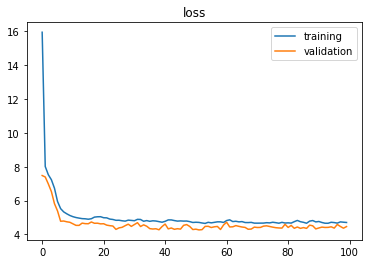

In [134]:
plt.plot(history.history['loss'],    label='training')
plt.plot(history.history['val_loss'],label='validation')
plt.title('loss')
plt.legend()

## Bước 7: Áp dụng, đánh giá mô hình trên tập test

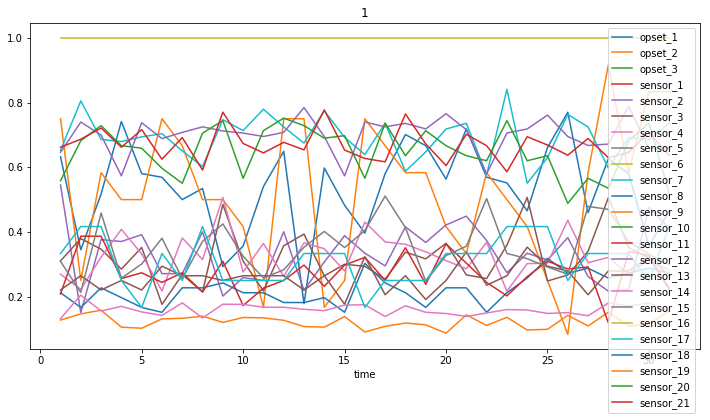

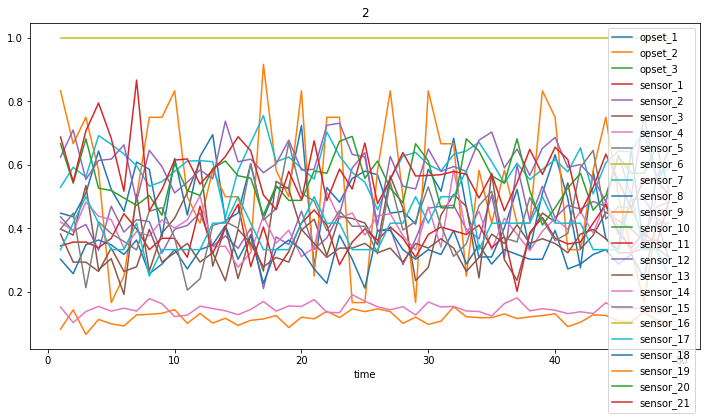

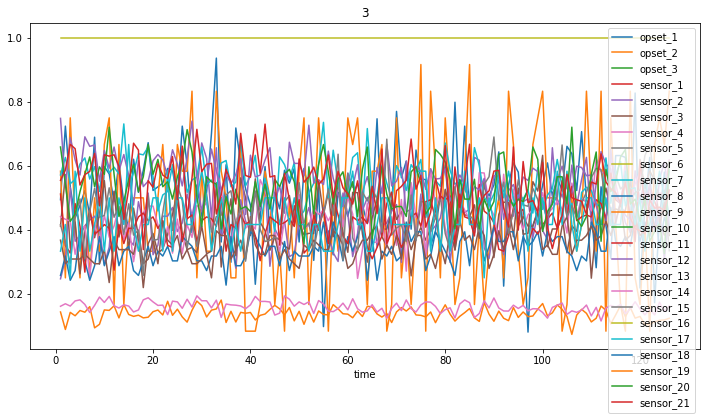

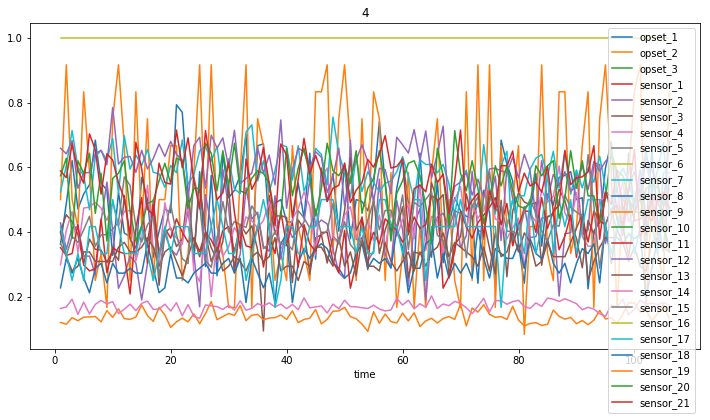

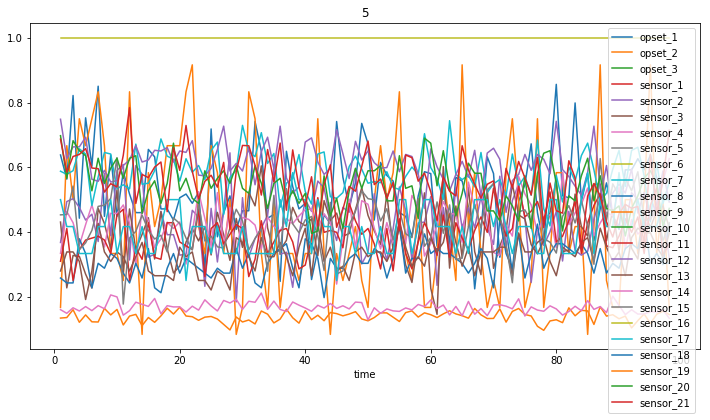

...

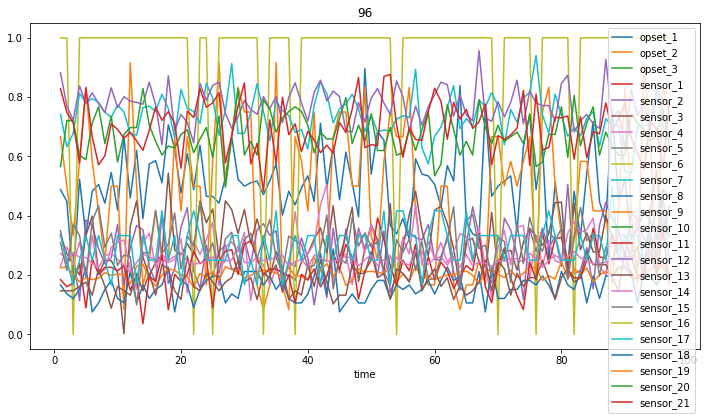

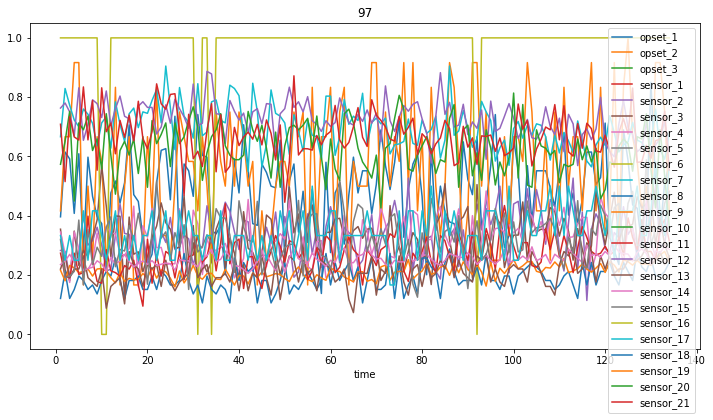

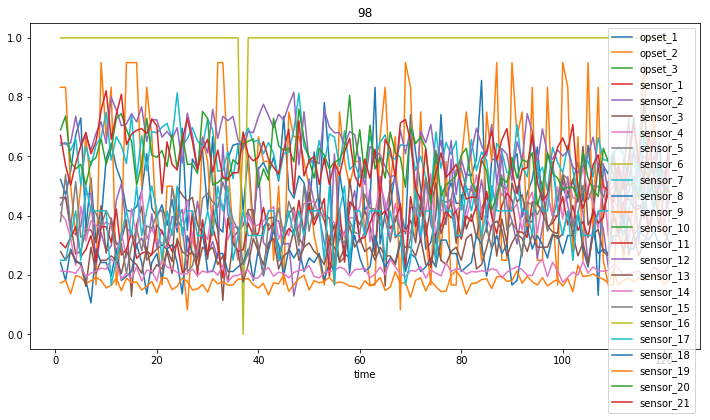

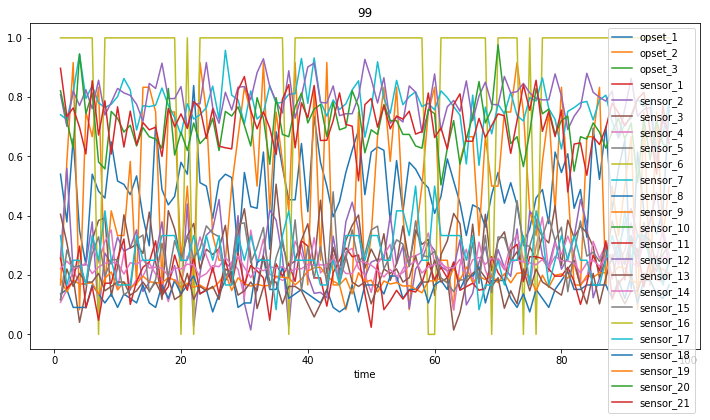

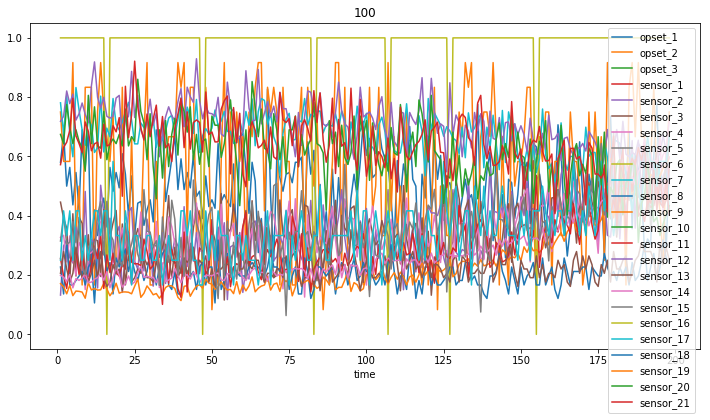

In [178]:
mins=train_orig[feature_cols].min()
maxs=train_orig[feature_cols].max()

for unit, grp in test_x_orig.groupby('unit'):
    df=grp.set_index('time')
    df = df[feature_cols]
    df=(df - mins)/ (maxs - mins)
    df.plot(figsize=(12,6))
    plt.title(unit)
    plt.show()

## Ước tính 2 tham số alpha, beta cho 100 cái máy trong tập test

In [140]:
test_predict = model.predict(test_x) # Đây thực chất là 2 tham số alpha, beta của phân phối Weibull rời rạc

test_predict[0:10]

array([[272.60483  ,   3.99602  ],
       [156.92627  ,   3.561118 ],
       [ 76.35969  ,   3.453393 ],
       [ 96.28304  ,   3.4027443],
       [121.58677  ,   3.331771 ],
       [167.7803   ,   3.5871906],
       [149.55699  ,   3.4486532],
       [101.03588  ,   3.3714018],
       [160.90857  ,   3.5496147],
       [ 95.91266  ,   3.0345428]], dtype=float32)

In [143]:
# Đặt song song giá trị dự báo và tuổi thọ của máy trong tập test

test_predict = np.resize(test_predict, (100, 2))
test_result = np.concatenate((test_y, test_predict), axis=1)

test_result[0:10]

array([[112.        ,   1.        , 272.60482788,   3.99602008],
       [ 98.        ,   1.        , 156.92626953,   3.56111789],
       [ 69.        ,   1.        ,  76.35968781,   3.45339298],
       [ 82.        ,   1.        ,  96.28304291,   3.40274429],
       [ 91.        ,   1.        , 121.5867691 ,   3.3317709 ],
       [ 93.        ,   1.        , 167.78030396,   3.58719063],
       [ 91.        ,   1.        , 149.55699158,   3.44865322],
       [ 95.        ,   1.        , 101.03588104,   3.37140179],
       [111.        ,   1.        , 160.90856934,   3.54961467],
       [ 96.        ,   1.        ,  95.91265869,   3.0345428 ]])

### Tạo dataframe để đánh giá hiệu quả mô hình

In [145]:
test_results_df = pd.DataFrame(test_result, columns=['Time', 'Event', 'alpha', 'beta'])
test_results_df['Machine'] = np.arange(1, test_results_df.shape[0]+1)

test_results_df

,Time,Event,alpha,beta,Machine
0,112.0,1.0,272.604828,3.996020,1
1,98.0,1.0,156.926270,3.561118,2
2,69.0,1.0,76.359688,3.453393,3
3,82.0,1.0,96.283043,3.402744,4
4,91.0,1.0,121.586769,3.331771,5
...,...,...,...,...,...
95,137.0,1.0,180.738724,3.588734,96
96,82.0,1.0,102.846573,3.190151,97
97,59.0,1.0,72.318794,3.040407,98
98,117.0,1.0,176.477585,3.580384,99


### Chuẩn bị 4 hàm để chuyển từ 2 tham số alpha, beta và time thành pdf, mean, median và mode của biến kết quả Survival time

In [146]:
# Hàm mật độ xác suất phân phối Weibull
def weibull_pdf(alpha, beta, t):
    return (beta/alpha) * (t/alpha)**(beta-1)*np.exp(- (t/alpha)**beta)

# Hàm tính trung vị phân phối Weibull
def weibull_median(alpha, beta):
    return alpha*(-np.log(.5))**(1/beta)

# Hàm tính trung bình phân phối Weibull
def weibull_mean(alpha, beta):
    return alpha * math.gamma(1 + 1/beta)

# Hàm tính Mode phân phối Weibull
def weibull_mode(alpha, beta):
    assert np.all(beta > 1)
    return alpha * ((beta-1)/beta)**(1/beta)

### Phân phối Weibull tổng quát cho toàn bộ 100 cái máy trong tập test (quần thể)

In [174]:
def sample_plot(max_scale=150,data=test_results_df):
    t=np.arange(0,max_scale)
    alpha = test_results_df['alpha'].mean()
    beta = test_results_df['beta'].mean()
    mu = weibull_mean(alpha, beta)
    median =weibull_median(alpha, beta)
    mode = weibull_mode(alpha, beta)
    n, bins, patches = plt.hist(test_results_df['Time'],30, normed=1, facecolor='gold', label='Life_time')
    plt.plot(t, weibull_pdf(alpha,beta, t),ls="-",label="PDF")
    plt.axvline(mu, ls='--', color ='red',label='mean')
    plt.axvline(median, ls='--', color='blue', label='median')
    plt.axvline(mode, ls='--', color='green', label='mode')
    plt.legend()
    plt.gcf().set_size_inches(12,6)
    plt.title('Phân bố Weibull cho test set')

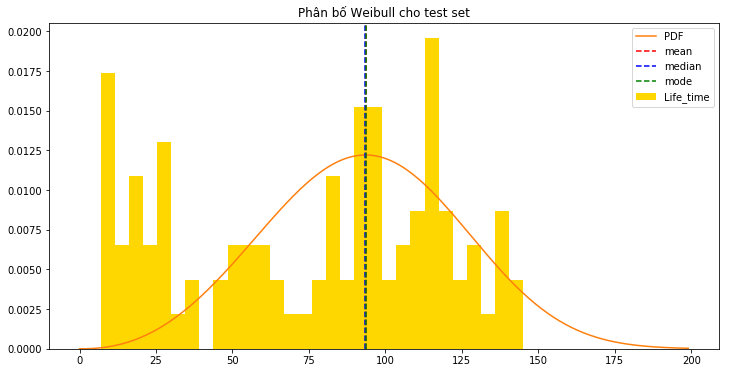

In [175]:
import math

sample_plot(200,test_results_df)

### Kết quả dự báo của mô hình cho từng cái máy (cá thể)

In [195]:
def plot_weibull_predictions(results_df):

    fig, axarr = plt.subplots(3, figsize=(20,30))

    t=np.arange(0,300)

    palette = sns.color_palette("RdBu_r", results_df.shape[0] + 1)
    color_dict = dict(enumerate(palette))

    for i, row in enumerate(results_df.iterrows()):
        alpha=row[1]['alpha']
        beta = row[1]['beta']
        T = row[1]['Time']
        label = 'a={} b={}'.format(alpha, beta)

        color = color_dict[i]
        ax= axarr[0]
        mode = weibull_mode(alpha, beta)
        y_max = weibull_pdf(alpha, beta, mode)    

        ax.plot(t, weibull_pdf(alpha, beta, t), color=color,alpha=0.3)
        ax.scatter(T, weibull_pdf(alpha,beta, T), color=color, s=100, alpha=0.5)
        ax.vlines(mode, ymin=0, ymax=y_max, colors=color, linestyles='-', alpha=0.5)
    
    ax=axarr[1]
    
    median_predictions = weibull_median(results_df['alpha'], results_df['beta'])
    mean_predictions = results_df[['alpha', 'beta']].apply(lambda row: weibull_mean(row[0], row[1]), axis=1)
    mode_predictions = weibull_mode(results_df['alpha'], results_df['beta'])
    
    ax.scatter(results_df['Time'], mode_predictions, label='m_prediction')
    ax.set_title('MAP prediction Vs. true')
    
    ax.legend()
    
    ax=axarr[2]
    sns.distplot(results_df['Time'] - mode_predictions, ax=ax)
    ax.set_title('Error')

    plt.show()

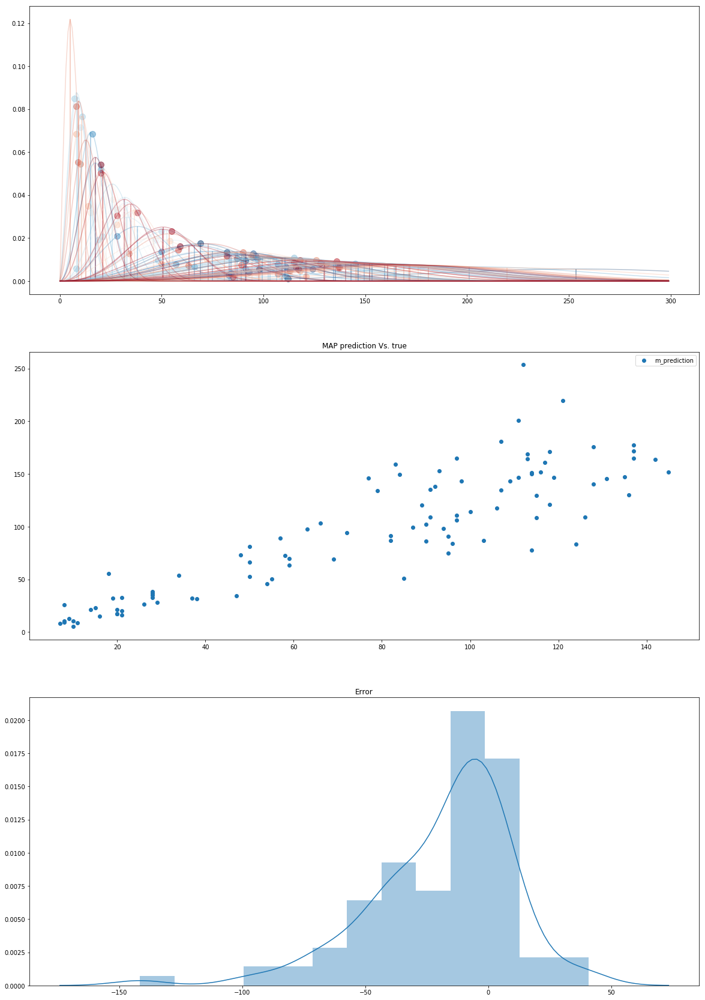

In [196]:
plot_weibull_predictions(test_results_df)

In [203]:
test_results_df['predicted_mu'] = test_results_df[['alpha', 'beta']].apply(lambda row: weibull_mean(row[0], row[1]), axis=1)
test_results_df['predicted_median'] = test_results_df[['alpha', 'beta']].apply(lambda row: weibull_median(row[0], row[1]), axis=1)
test_results_df['predicted_mode'] = test_results_df[['alpha', 'beta']].apply(lambda row: weibull_mode(row[0], row[1]), axis=1)
test_results_df['error'] = test_results_df['Time']-test_results_df['predicted_mu']

test_results_df

,Time,Event,alpha,beta,Machine,predicted_mu,predicted_median,predicted_mode,error
0,112.0,1.0,272.604828,3.996020,1,247.075707,248.714024,253.648129,-135.075707
1,98.0,1.0,156.926270,3.561118,2,141.324431,141.578640,143.052580,-43.324431
2,69.0,1.0,76.359688,3.453393,3,68.655870,68.670772,69.162243,0.344130
3,82.0,1.0,96.283043,3.402744,4,86.502565,86.451299,86.923675,-4.502565
4,91.0,1.0,121.586769,3.331771,5,109.117966,108.920986,109.236490,-18.117966
...,...,...,...,...,...,...,...,...,...
95,137.0,1.0,180.738724,3.588734,96,162.837115,163.191397,165.015094,-25.837115
96,82.0,1.0,102.846573,3.190151,97,92.101175,91.684140,91.409088,-10.101175
97,59.0,1.0,72.318794,3.040407,98,64.617681,64.105920,63.427881,-5.617681
98,117.0,1.0,176.477585,3.580384,99,158.978055,159.306008,161.049912,-41.978055


In [328]:
test_results_df.describe()

,Time,Event,alpha,beta,Machine,predicted_mu,predicted_median,predicted_mode,error
count,100.00000,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
mean,75.52000,1.0,104.397588,3.289744,50.500000,93.864754,93.829496,94.363431,-18.344754
std,41.76497,0.0,62.733270,0.365061,29.011492,56.639488,56.907607,57.859346,27.882238
min,7.00000,1.0,7.088881,2.022415,1.000000,6.281178,5.913880,5.059386,-135.075707
25%,32.75000,1.0,40.033031,3.135670,25.750000,35.953811,35.913665,36.175277,-34.055993
50%,86.00000,1.0,103.048576,3.412099,50.500000,92.573132,92.475225,92.877844,-12.029722
75%,112.25000,1.0,160.429657,3.541226,75.250000,144.291393,144.370402,145.502605,-1.086737
max,145.00000,1.0,272.604828,3.996020,100.000000,247.075707,248.714024,253.648129,39.560865


Biểu đồ và thống kê mô tả cho thấy mô hình đã dự báo khá hiệu quả tuổi thọ của từng cái máy dựa vào 100 ngày theo dõi đầu tiên của 17 tín hiệu. Sai số dự báo trung bình là -18 ngày, trung vị là -12 ngày (khoảng 2 tuần trước khi biến cố thực sự diễn ra).

Các biểu đồ sau đây cho thấy có tương quan tuyến tính mạnh giữa tuổi thọ thực tế và tuổi thọ dự báo bằng mô hình.

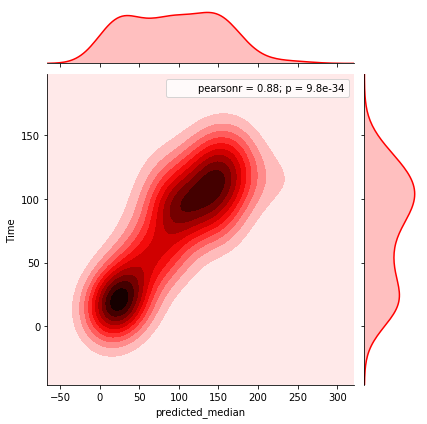

In [199]:
sns.jointplot(data=test_results_df, y='Time', x='predicted_median',kind="kde",color="r")

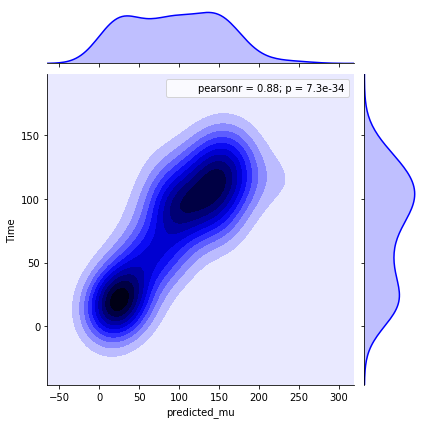

In [201]:
sns.jointplot(data=test_results_df, y='Time', x='predicted_mu',kind="kde",color="b")

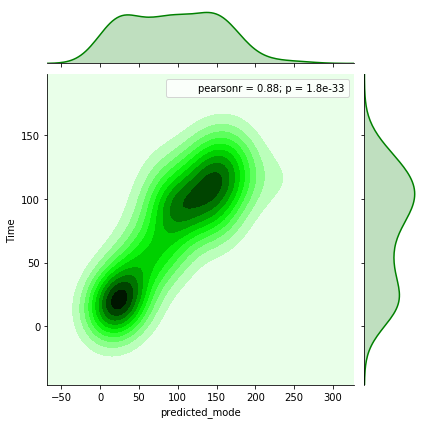

In [202]:
sns.jointplot(data=test_results_df, y='Time', x='predicted_mode',kind="kde",color="g")

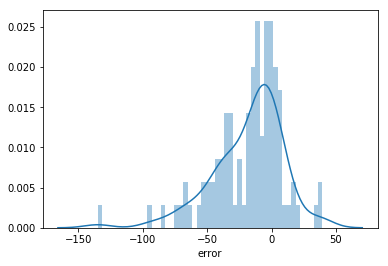

In [204]:
sns.distplot(test_results_df['error'], bins=50)

## Bước 8: Ta có thể giải thích mô hình hay không ?

Có thể thấy trước rằng mô hình Weibull RNN hiện thời gần như không thể diễn giải được một cách trực tiếp, tuy nhiên Nhi thử dùng phương pháp SHAP để giải thích hoạt động của mô hình, ở cấp độ cá thể cho 1 cái máy đầu tiên trong tập test:

Dùng hàm DeepExplainer cho 5000 mẫu đầu tiên trong tập train_x, ta có 1 explainer. Áp dụng explainer này cho cái máy đầu tiên: test_x[:1], ta sẽ tính được shap_values cho mỗi features và tại mỗi thời điểm trong 100 ngày theo dõi.

In [295]:
import shap

# we use the first 100 training examples as our background dataset to integrate over
explainer = shap.DeepExplainer(model, train_x[:5000])

# init the JS visualization code
shap.initjs()

shap_values = explainer.shap_values(test_x[:1])

In [296]:
explainer.expected_value

array([129.60759  ,   3.3955016], dtype=float32)

Ta thử xem vai trò đóng góp của mổi features tại ngày thứ nhất, ngày thứ 50 và ngày thứ 100 đối với kết quả dự báo tham số alpha:

In [322]:
shap.force_plot(explainer.expected_value[0],shap_values[1][0][0])

In [323]:
shap.force_plot(explainer.expected_value[0],shap_values[1][0][49])

In [324]:
shap.force_plot(explainer.expected_value[0],shap_values[1][0][99])

Tương tự, đây là kết quả giải thích về vai trò của các features tại ngày thứ 99 cho tham số beta:

In [320]:
shap.force_plot(explainer.expected_value[1],shap_values[1][0][99])

Bao quát cho 100 ngày theo dõi:

In [316]:
shap.force_plot(explainer.expected_value[0],shap_values[0][0],test_x[0])

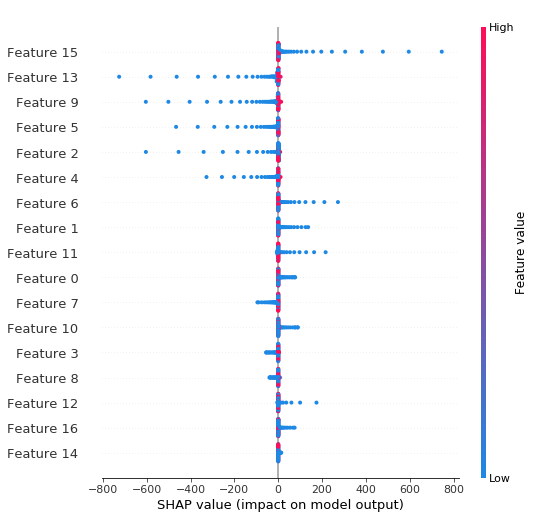

In [317]:
shap.summary_plot(shap_values[0][0],test_x[0],plot_type='dot',color="red")

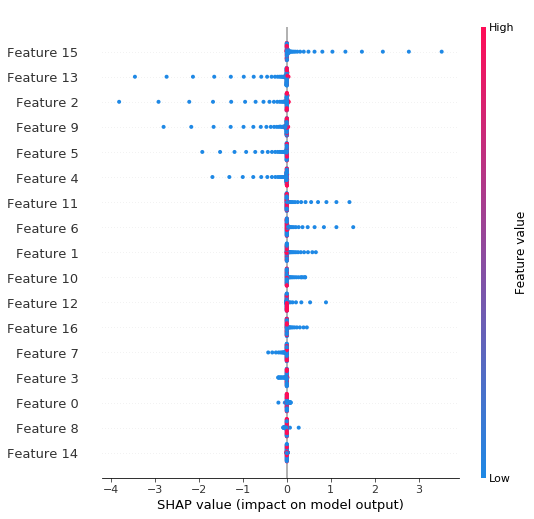

In [318]:
shap.summary_plot(shap_values[1][0],test_x[0],plot_type='dot',color="blue")

In [310]:
test_results_df.iloc[0]

Time                112.000000
Event                 1.000000
alpha               272.604828
beta                  3.996020
Machine               1.000000
predicted_mu        247.075707
predicted_median    248.714024
predicted_mode      253.648129
error              -135.075707
Name: 0, dtype: float64

# Tổng kết

Bài thực hành đến đây là hết. Chúng ta vừa sử dụng phương pháp WTTE_RNN (Weibull time to event estimation by Recurrent neural network), của tác giả Egil Martinsson. Ý tưởng là dùng một quy luật phân bố để ước tính giá trị của kết quả như 1 biến ngẫu nhiên, phân bố này sẽ có vai trò hoa tiêu, chỉ huy và định hướng cho quá trình huấn luyện mô hình để đạt kết quả log_likelihood (hàm loss) tối ưu, cho phép xuất ra 2 tham số để từ đó ước tính được kết quả cần tiên lượng. 

So với mô hình parametric survival theo kiểu tuyến tính thông thường, mô hình Weibull RNN có ưu điểm và nhược điểm như sau:

Về nhược điểm, mô hình Survival Deep learning không diễn giải được, không tính được các chỉ số suy diễn thống kê như Survival, Hazard_ratio, rất khó diễn giải vai trò của từng features. 

Về ưu điểm, ta tận dụng được ưu thế của Deep learning, bao gồm khả năng thích nghi cao với nhiễu, tương tác phi tuyến tính; đơn giản hóa khâu dựng mô hình (cấu trúc mô hình chỉ cần dựng một lần, và nhẹ nhàng), 1 mô hình mạng duy nhất xử lý toàn bộ dữ liệu và xuất toàn bộ tham số cùng lúc. Mô hình tiếp nhận được dữ liệu dữ liệu chuỗi và phi cấu trúc (ảnh chụp, video, cảm biến trên mặt phẳng tọa độ hay trong không gian 3 chiều). 